In [196]:
"""
Se realiza un trabajo analogo al desarrollado por Mauricio Canals en el paper "Análisis no-lineal de la dinámica de enfermedades infecciosas en Chile"
"""

'\nSe realiza un trabajo analogo al desarrollado por Mauricio Canals en el paper "Análisis no-lineal de la dinámica de enfermedades infecciosas en Chile"\n'

In [197]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy
import statsmodels.api as sm
from matplotlib import animation

## Analisis de RM: Dimension de inmersion, tiempo de retardo y coef de Lyapunov

Ocupo el paquete $nolitsa$ para python que contiene varias funciones para Series de Tiempo (ver https://github.com/manu-mannattil/nolitsa)

In [198]:
data = pd.read_excel(r'C:\Users\ignac\OneDrive - Universidad de Chile\Escritorio\Practica-II-Covid-1\data\covid19 CHILE REGIONES-CURSOMM.xlsx', sheet_name='Casos', parse_dates=['fecha'], index_col='fecha')

RM = data['RM'].dropna()

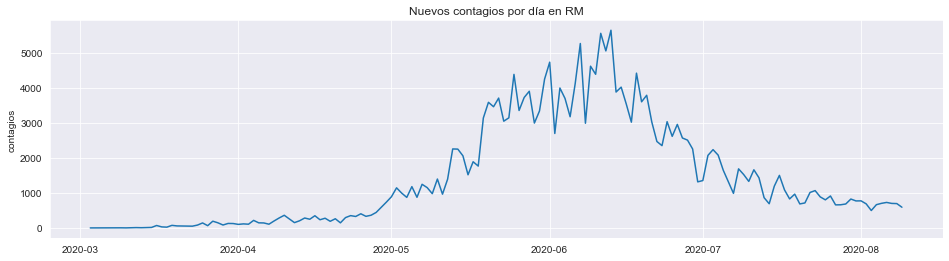

In [199]:
sns.set_style('darkgrid')

plt.figure(0, figsize=(16,4))
plt.clf()
plt.plot(RM)
plt.title('Nuevos contagios por día en RM')
plt.ylabel('contagios')
plt.show()

In [200]:
from nolitsa import data, dimension, delay, noise, lyapunov
from mpl_toolkits.mplot3d import Axes3D
from statsmodels.tsa.filters.hp_filter import hpfilter

In [201]:
from sklearn.metrics import mutual_info_score
from scipy.stats import chi2_contingency

In [202]:
#def calc_MI(x, y, bins):
#    c_xy = np.histogram2d(x, y, bins)[0]
#    g, p, dof, expected = chi2_contingency(c_xy, lambda_="log-likelihood")
#    mi = 0.5 * g / c_xy.sum()
#    return mi

def calc_MI(x, y, bins):
    """
    Entrega la informacion mutua para dos series de datos
    """
    c_xy = np.histogram2d(x, y, bins)[0]
    mi = mutual_info_score(None, None, contingency=c_xy)
    return mi

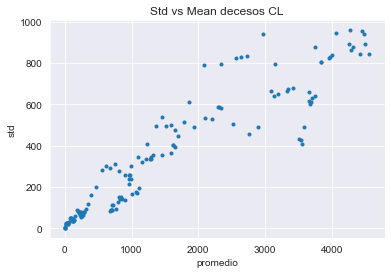

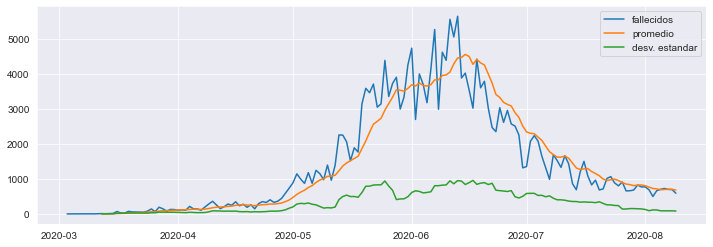

In [203]:
# Se observa no estacionalidad

roll_mean = RM.rolling(window=10).mean()
roll_std = RM.rolling(window=10).std()

plt.figure(9)
plt.clf()
plt.plot(roll_mean, roll_std, '.')
plt.title('Std vs Mean decesos CL')
plt.xlabel('promedio')
plt.ylabel('std')
plt.show()

plt.figure(10, figsize=(12,4))
plt.clf()
plt.plot(RM, label='fallecidos')
plt.plot(roll_mean, label='promedio')
plt.plot(roll_std, label='desv. estandar')
plt.legend()
plt.show()

Estandarizamos dividiendo por el máximo de $S_t$ y removemos la estacionalidad de $S_t$ como en el paper de Canals: $W_t = S_t - S_{t-12}$


In [204]:
RM_standar = pd.DataFrame(RM / RM.max())
tau = 12

def difference(x, d=1):
    if d == 0:
        return x
    else:
        x = np.r_[x[0], np.diff(x)]
        return difference(x, d - 1)
    
def undo_difference(x, d=1):
    if d == 1:
        return np.cumsum(x)
    else:
        x = np.cumsum(x)
        return undo_difference(x, d - 1)

In [205]:
RM_unlagged = RM_standar.RM[:-tau]
RM_lagged = np.roll(RM_standar.RM, -tau)[:-tau]

W = RM_unlagged - RM_lagged

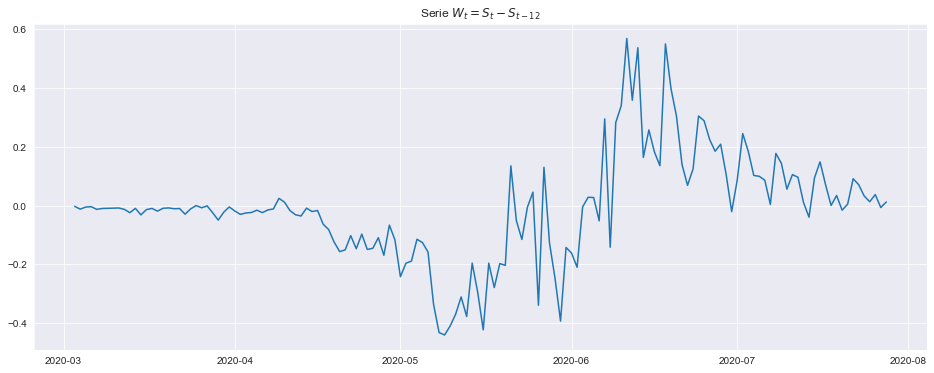

In [206]:
plt.figure(0, figsize=(16,6))
plt.plot(W)
plt.title('Serie $W_t = S_t - S_{t-12}$')
plt.show()

In [207]:
from statsmodels.tsa.stattools import adfuller

# Chequeamos si hay estacionalidad (la hay)

# Dickey-Fuller test
print('Resultados del test de Dickey Fuller')

dftest = adfuller(W, autolag='AIC')
dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
for key, value in dftest[4].items():
    dfoutput['Critical Value (%s)'%key] = value
    
print(dfoutput)


Resultados del test de Dickey Fuller
Test Statistic                  -1.586848
p-value                          0.490197
#Lags Used                      12.000000
Number of Observations Used    135.000000
Critical Value (1%)             -3.479743
Critical Value (5%)             -2.883198
Critical Value (10%)            -2.578320
dtype: float64


### Como no hemos removido la estacionalidad, procedemos a remover la estacionalidad con el filtro de Hodrick-Prescott (como lo sugerido en el paper de Elena Olmedo, Is there chaos in the Spanish labour market?)

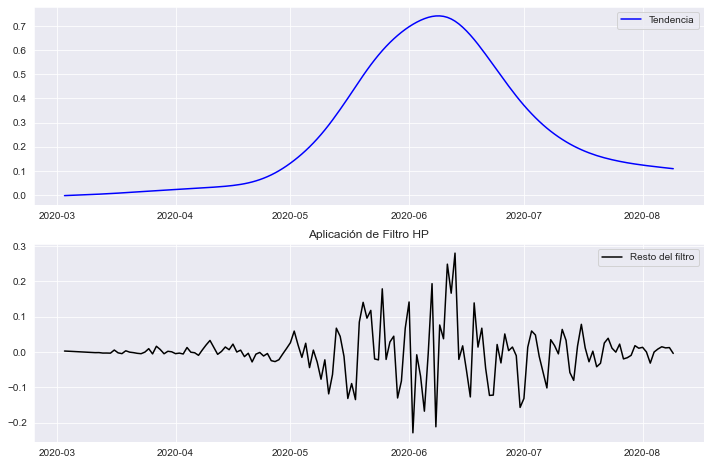

In [208]:
RM_cycle, RM_trend = hpfilter(RM_standar)

fig, axes = plt.subplots(2, 1, figsize=(12, 8))
fig.clf()

axes = [fig.add_subplot(211), fig.add_subplot(212)]

axes[0].plot(RM_trend, color='blue', label='Tendencia')
axes[0].legend()

plt.title('Aplicación de Filtro HP')
axes[1].plot(RM_cycle, color='black', label='Resto del filtro')
axes[1].legend()

plt.show()

In [209]:
# Vemos is la parte ciclica es no estacionaria (si es no estacionaria)

# Dickey-Fuller test
print('Resultados del test de Dickey Fuller')

dftest = adfuller(RM_cycle, autolag='AIC')
dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
for key, value in dftest[4].items():
    dfoutput['Critical Value (%s)'%key] = value
    
print(dfoutput)

Resultados del test de Dickey Fuller
Test Statistic                  -5.082361
p-value                          0.000015
#Lags Used                       8.000000
Number of Observations Used    151.000000
Critical Value (1%)             -3.474416
Critical Value (5%)             -2.880878
Critical Value (10%)            -2.577081
dtype: float64


###  Asi, si bien con un Lag no pudimos estacionalizar la serie como en el paper de Canals, consideraremos el filtro obtenido por el metodo de Hodrick-Prescott $C(RM)$

## Reconstruccion de atractores

Procedemos a sacar el tiempo de retardo según la heuristica de tomar el primer mínimo de la funcion de Informacion Mutual. (Poner paper que hable de eso)

tiempo optimo de retardo tau = 6


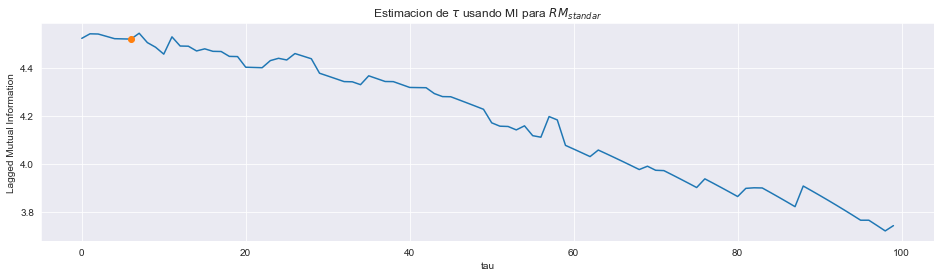

In [210]:
tau_max = 100
mutual_info = []
stop = 0

for tau in range(1, tau_max+1):
    unlagged = RM_standar.RM[:-tau]
    lagged = np.roll(RM_standar.RM, -tau)[:-tau]
    mutual_info.append(calc_MI(lagged, unlagged, 1000))

    if stop == 0 and len(mutual_info)>2 and mutual_info[-2] < min([mutual_info[-1], mutual_info[-3]]):
        tau -= 2
        stop += 1
        tau_op = tau
        print('tiempo optimo de retardo tau = {}'.format(tau))
plt.figure(11, figsize=(16,4))
plt.clf()
plt.plot(np.arange(tau_max), mutual_info, tau_op, mutual_info[tau_op], 'o')
plt.xlabel('tau')
plt.ylabel('Lagged Mutual Information')
plt.title('Estimacion de $\\tau$ usando MI para $RM_{standar}$')
plt.show()

tiempo optimo de retardo tau = 1


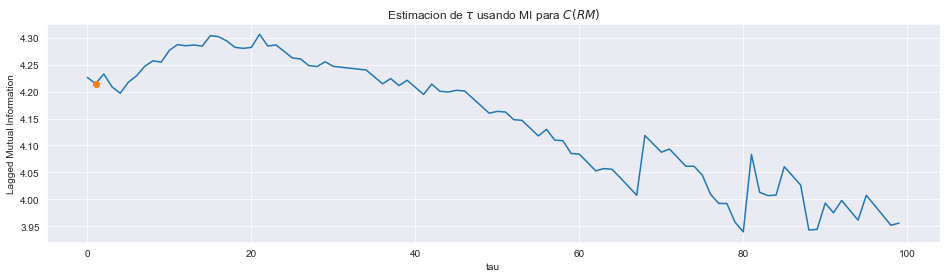

In [211]:
tau_max = 100
mutual_info = []
stop = 0

for tau in range(1, tau_max+1):
    unlagged = np.array(RM_cycle)[:-tau]
    lagged = np.roll(np.array(RM_cycle), -tau)[:-tau]
    mutual_info.append(calc_MI(lagged, unlagged, 1000))

    if stop == 0 and len(mutual_info)>2 and mutual_info[-2] < min([mutual_info[-1], mutual_info[-3]]):
        tau -= 2
        stop += 1
        tau_op = tau
        print('tiempo optimo de retardo tau = {}'.format(tau))
plt.figure(11, figsize=(16,4))
plt.clf()
plt.plot(np.arange(tau_max), mutual_info, tau_op, mutual_info[tau_op], 'o')
plt.xlabel('tau')
plt.ylabel('Lagged Mutual Information')
plt.title('Estimacion de $\\tau$ usando MI para $C(RM)$')
plt.show()

### Obtenemos $\tau=6$ y $\tau = 1$ para $S_t$ y $CS_t$ respectivamente (aunque el segundo minimo de $CS_t$ es 4)
### Procedemos a obtener la dimension de encaje

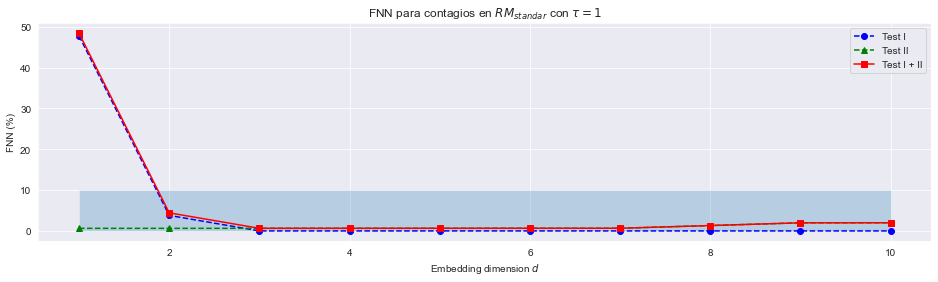

In [213]:
dim = np.arange(1, 10 + 1)
f1, f2, f3 = dimension.fnn(np.array(RM), tau=1, dim=dim, window=10, metric='chebyshev')

plt.figure(12, figsize=(16,4))
plt.clf()
plt.title('FNN para contagios en $RM_{standar}$ con $\\tau=1$')
plt.xlabel('Embedding dimension $d$')
plt.ylabel('FNN (%)')
plt.plot(dim, 100 * f1, 'bo--', label=r'Test I')
plt.plot(dim, 100 * f2, 'g^--', label=r'Test II')
plt.plot(dim, 100 * f3, 'rs-', label=r'Test I + II')
plt.fill_between(dim, 10, alpha=0.25)
plt.legend()
plt.show()

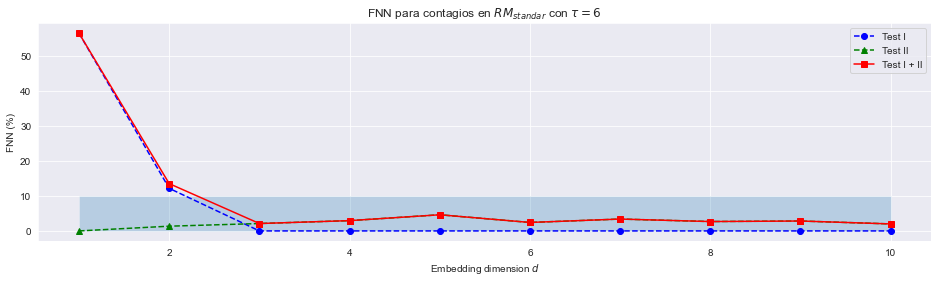

In [214]:
dim = np.arange(1, 10 + 1)
f1, f2, f3 = dimension.fnn(np.array(RM), tau=6, dim=dim, window=10, metric='chebyshev')

plt.figure(12, figsize=(16,4))
plt.clf()
plt.title('FNN para contagios en $RM_{standar}$ con $\\tau=6$')
plt.xlabel('Embedding dimension $d$')
plt.ylabel('FNN (%)')
plt.plot(dim, 100 * f1, 'bo--', label=r'Test I')
plt.plot(dim, 100 * f2, 'g^--', label=r'Test II')
plt.plot(dim, 100 * f3, 'rs-', label=r'Test I + II')
plt.fill_between(dim, 10, alpha=0.25)
plt.legend()
plt.show()

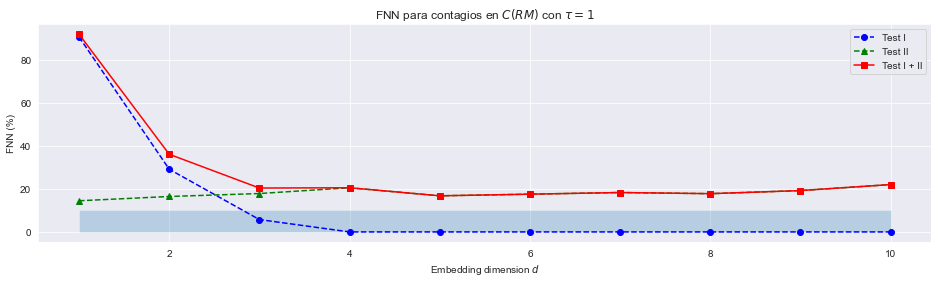

In [192]:
dim = np.arange(1, 10 + 1)
f1, f2, f3 = dimension.fnn(np.array(RM_cycle), tau=1, dim=dim, window=10, metric='chebyshev')

plt.figure(12, figsize=(16,4))
plt.clf()
plt.title('FNN para contagios en $C(RM)$ con $\\tau=1$')
plt.xlabel('Embedding dimension $d$')
plt.ylabel('FNN (%)')
plt.plot(dim, 100 * f1, 'bo--', label=r'Test I')
plt.plot(dim, 100 * f2, 'g^--', label=r'Test II')
plt.plot(dim, 100 * f3, 'rs-', label=r'Test I + II')
plt.fill_between(dim, 10, alpha=0.25)
plt.legend()
plt.show()

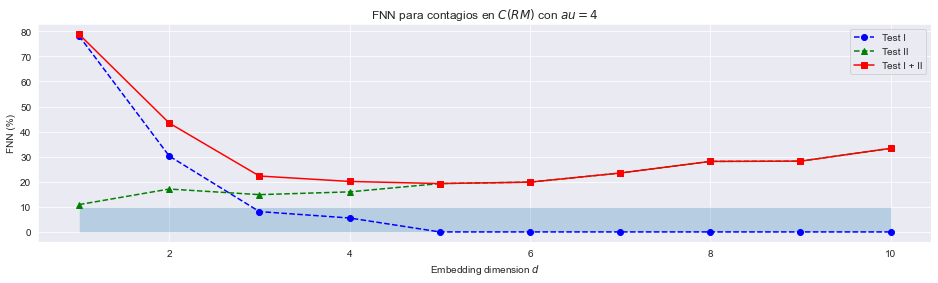

In [193]:
dim = np.arange(1, 10 + 1)
f1, f2, f3 = dimension.fnn(np.array(RM_cycle), tau=4, dim=dim, window=10, metric='chebyshev')

plt.figure(12, figsize=(16,4))
plt.clf()
plt.title('FNN para contagios en $C(RM)$ con $\tau=4$')
plt.xlabel('Embedding dimension $d$')
plt.ylabel('FNN (%)')
plt.plot(dim, 100 * f1, 'bo--', label=r'Test I')
plt.plot(dim, 100 * f2, 'g^--', label=r'Test II')
plt.plot(dim, 100 * f3, 'rs-', label=r'Test I + II')
plt.fill_between(dim, 10, alpha=0.25)
plt.legend()
plt.show()

### Procedemos a sacar las dimensiones de correlacion

In [215]:
import nolds

def difference(x, d=1):
    if d == 0:
        return x
    else:
        x = np.r_[x[0], np.diff(x)]
        return difference(x, d - 1)


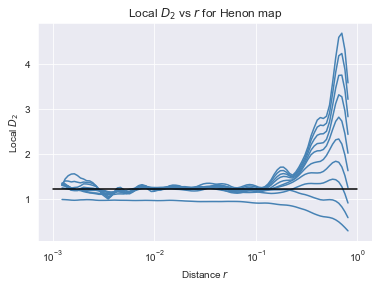

In [216]:
import numpy as np
import matplotlib.pyplot as plt
from nolitsa import d2, data, utils

x = utils.rescale(data.henon(length=5000)[:, 0])

dim = np.arange(1, 10 + 1)
tau = 1

plt.title('Local $D_2$ vs $r$ for Henon map')
plt.xlabel(r'Distance $r$')
plt.ylabel(r'Local $D_2$')

for r, c in d2.c2_embed(x, tau=tau, dim=dim, window=2,
                        r=utils.gprange(0.001, 1.0, 100)):
    plt.semilogx(r[3:-3], d2.d2(r, c), color='#4682B4')

plt.semilogx(utils.gprange(0.001, 1.0, 100), 1.220 * np.ones(100),
             color='#000000')
plt.show()

In [217]:
len(x)

5000

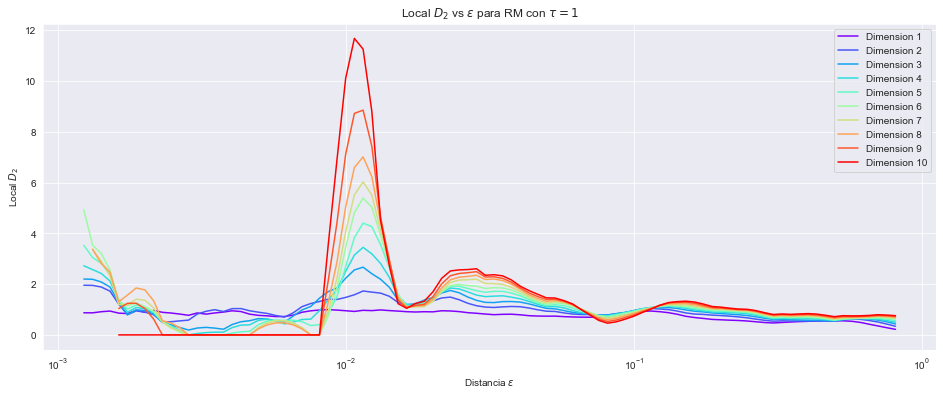

In [218]:
import matplotlib.cm as cm

dim = np.arange(1, 10 + 1)
tau = 1
x = utils.rescale(RM)

plt.figure(3, figsize=(16, 6))
plt.title('Local $D_2$ vs $\\varepsilon$ para RM con $\\tau = 1$')
plt.xlabel(r'Distancia $\varepsilon$')
plt.ylabel(r'Local $D_2$')

colors = cm.rainbow(np.linspace(0, 1, len(dim)))
i = 0
for r, c in d2.c2_embed(x, tau=tau, dim=dim, window=2):
    plt.semilogx(r[3:-3], d2.d2(r, c), color=colors[i], label='Dimension {}'.format(i+1))
    i += 1
plt.legend()
# plt.semilogx(utils.gprange(0.001, 1.0, 100), 1.220 * np.ones(100), color='#000000')
plt.show()

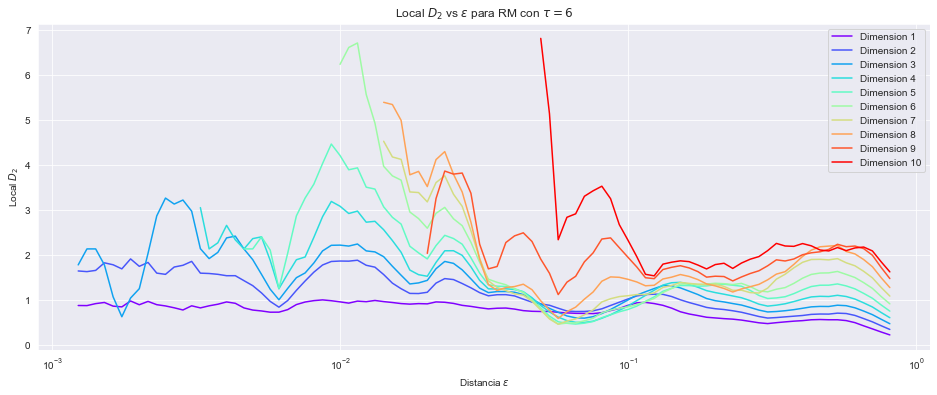

In [219]:
dim = np.arange(1, 10 + 1)
tau = 6
x = utils.rescale(RM)

plt.figure(3, figsize=(16, 6))
plt.title('Local $D_2$ vs $\\varepsilon$ para RM con $\\tau = 6$')
plt.xlabel(r'Distancia $\varepsilon$')
plt.ylabel(r'Local $D_2$')

colors = cm.rainbow(np.linspace(0, 1, len(dim)))
i = 0
for r, c in d2.c2_embed(x, tau=tau, dim=dim, window=2):
    plt.semilogx(r[3:-3], d2.d2(r, c), color=colors[i], label='Dimension {}'.format(i+1))
    i += 1
plt.legend()
# plt.semilogx(utils.gprange(0.001, 1.0, 100), 1.220 * np.ones(100), color='#000000')
plt.show()

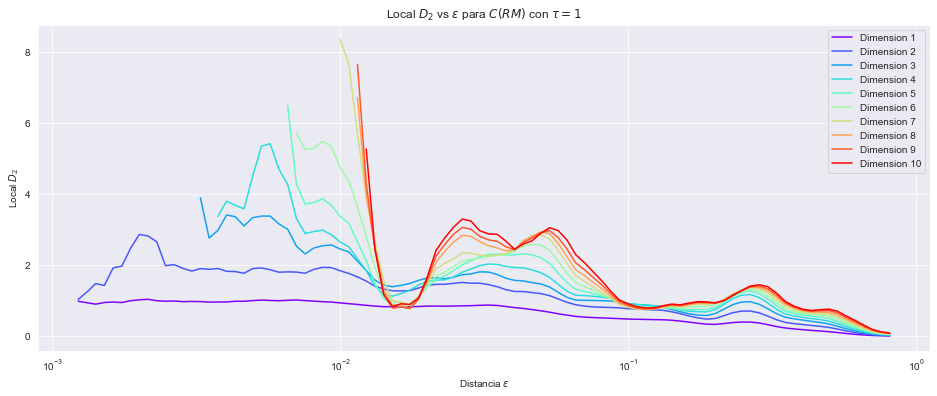

In [220]:
import matplotlib.cm as cm

dim = np.arange(1, 10 + 1)
tau = 1
x = utils.rescale(RM_cycle)

plt.figure(3, figsize=(16, 6))
plt.title('Local $D_2$ vs $\\varepsilon$ para $C(RM)$ con $\\tau=1$')
plt.xlabel(r'Distancia $\varepsilon$')
plt.ylabel(r'Local $D_2$')

colors = cm.rainbow(np.linspace(0, 1, len(dim)))
i = 0
for r, c in d2.c2_embed(x, tau=tau, dim=dim, window=5):
    plt.semilogx(r[3:-3], d2.d2(r, c), color=colors[i], label='Dimension {}'.format(i+1))
    i += 1
plt.legend()
# plt.semilogx(utils.gprange(0.001, 1.0, 100), 1.220 * np.ones(100), color='#000000')
plt.show()

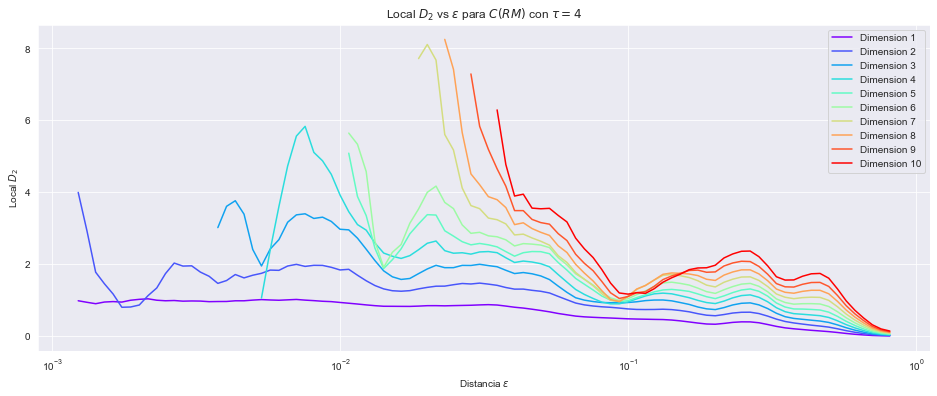

In [221]:
import matplotlib.cm as cm

dim = np.arange(1, 10 + 1)
tau = 4
x = utils.rescale(RM_cycle)

plt.figure(3, figsize=(16, 6))
plt.title('Local $D_2$ vs $\\varepsilon$ para $C(RM)$ con $\\tau=4$')
plt.xlabel(r'Distancia $\varepsilon$')
plt.ylabel(r'Local $D_2$')

colors = cm.rainbow(np.linspace(0, 1, len(dim)))
i = 0
for r, c in d2.c2_embed(x, tau=tau, dim=dim, window=5):
    plt.semilogx(r[3:-3], d2.d2(r, c), color=colors[i], label='Dimension {}'.format(i+1))
    i += 1
plt.legend()
# plt.semilogx(utils.gprange(0.001, 1.0, 100), 1.220 * np.ones(100), color='#000000')
plt.show()

### Ahora sacamos los exponentes de Lyapunov

In [222]:
nolds.lyap_r(RM_cycle, emb_dim=2, lag=1)

0.02688715863241495

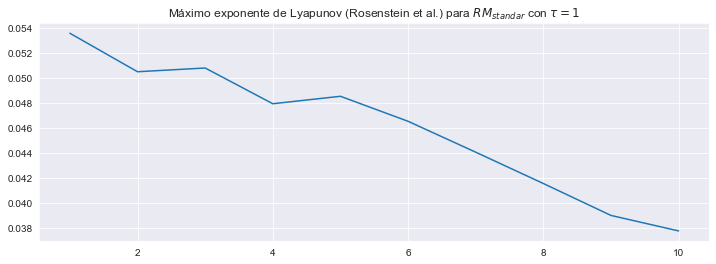

In [223]:
lyap_exp = []
dim = np.arange(1, 10 + 1)

for i in dim:
    lyap_exp.append(nolds.lyap_r(RM_standar.RM, emb_dim=i, lag=1))

plt.figure(14, figsize=(12, 4))
plt.plot(dim, lyap_exp)
plt.title('Máximo exponente de Lyapunov (Rosenstein et al.) para $RM_{standar}$ con $\\tau=1$')
plt.show()

In [224]:
tabla = pd.DataFrame(columns=['Dimension', 'Dim. de Corr.', 'Max. exp. de Lyapunov'])
tabla['Dimension'] = dim
tabla['Dim. de Corr.'] = dim_corr
tabla['Max. exp. de Lyapunov'] = lyap_exp
tabla.index = tabla['Dimension']
tabla.drop(columns='Dimension', inplace=True)
tabla

,Dim. de Corr.,Max. exp. de Lyapunov
Dimension,,
1,0.739304,0.053556
2,1.076981,0.050478
3,1.316387,0.050777
4,1.487500,0.047919
5,1.595237,0.048515
6,1.662355,0.046516
7,1.629886,0.044046
8,1.557328,0.041542
9,1.480439,0.038988


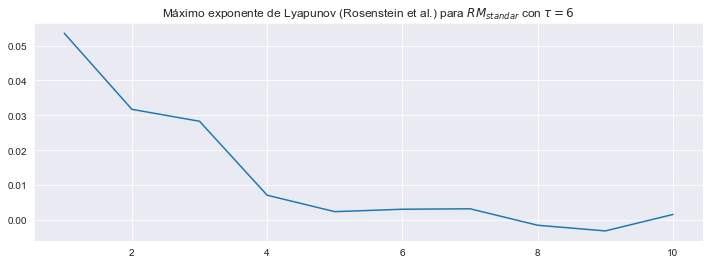

In [225]:
lyap_exp = []
dim = np.arange(1, 10 + 1)

for i in dim:
    lyap_exp.append(nolds.lyap_r(RM_standar.RM, emb_dim=i, lag=6))

plt.figure(14, figsize=(12, 4))
plt.plot(dim, lyap_exp)
plt.title('Máximo exponente de Lyapunov (Rosenstein et al.) para $RM_{standar}$ con $\\tau=6$')
plt.show()

In [226]:
tabla = pd.DataFrame(columns=['Dimension', 'Dim. de Corr.', 'Max. exp. de Lyapunov'])
tabla['Dimension'] = dim
tabla['Dim. de Corr.'] = dim_corr
tabla['Max. exp. de Lyapunov'] = lyap_exp
tabla.index = tabla['Dimension']
tabla.drop(columns='Dimension', inplace=True)
tabla

,Dim. de Corr.,Max. exp. de Lyapunov
Dimension,,
1,0.739304,0.053556
2,1.076981,0.031723
3,1.316387,0.028295
4,1.487500,0.007075
5,1.595237,0.002356
6,1.662355,0.003050
7,1.629886,0.003179
8,1.557328,-0.001546
9,1.480439,-0.003170


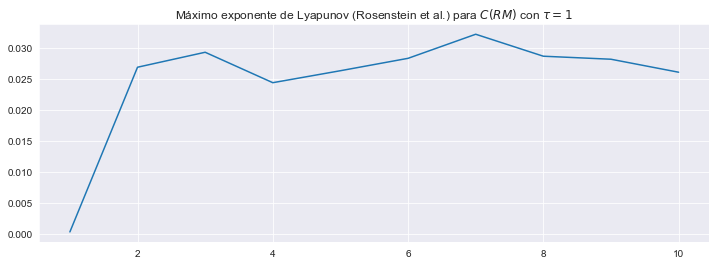

In [227]:
lyap_exp = []
dim = np.arange(1, 10 + 1)

for i in dim:
    lyap_exp.append(nolds.lyap_r(RM_cycle, emb_dim=i, lag=1))

plt.figure(14, figsize=(12, 4))
plt.plot(dim, lyap_exp)
plt.title('Máximo exponente de Lyapunov (Rosenstein et al.) para $C(RM)$ con $\\tau=1$')
plt.show()

In [228]:
tabla = pd.DataFrame(columns=['Dimension', 'Dim. de Corr.', 'Max. exp. de Lyapunov'])
tabla['Dimension'] = dim
tabla['Dim. de Corr.'] = dim_corr
tabla['Max. exp. de Lyapunov'] = lyap_exp
tabla.index = tabla['Dimension']
tabla.drop(columns='Dimension', inplace=True)
tabla

,Dim. de Corr.,Max. exp. de Lyapunov
Dimension,,
1,0.739304,0.000300
2,1.076981,0.026887
3,1.316387,0.029303
4,1.487500,0.024390
5,1.595237,0.026324
6,1.662355,0.028325
7,1.629886,0.032212
8,1.557328,0.028665
9,1.480439,0.028177


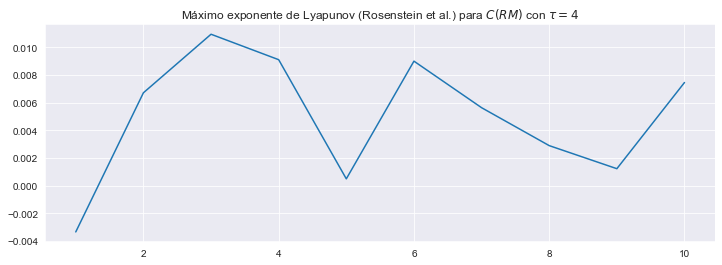

In [229]:
lyap_exp = []
dim = np.arange(1, 10 + 1)

for i in dim:
    lyap_exp.append(nolds.lyap_r(RM_cycle, emb_dim=i, lag=4))

plt.figure(14, figsize=(12, 4))
plt.plot(dim, lyap_exp)
plt.title('Máximo exponente de Lyapunov (Rosenstein et al.) para $C(RM)$ con $\\tau=4$')
plt.show()

In [230]:
tabla = pd.DataFrame(columns=['Dimension', 'Dim. de Corr.', 'Max. exp. de Lyapunov'])
tabla['Dimension'] = dim
tabla['Dim. de Corr.'] = dim_corr
tabla['Max. exp. de Lyapunov'] = lyap_exp
tabla.index = tabla['Dimension']
tabla.drop(columns='Dimension', inplace=True)
tabla

,Dim. de Corr.,Max. exp. de Lyapunov
Dimension,,
1,0.739304,-0.003341
2,1.076981,0.006718
3,1.316387,0.010952
4,1.487500,0.009112
5,1.595237,0.000496
6,1.662355,0.009006
7,1.629886,0.005641
8,1.557328,0.002898
9,1.480439,0.001230


In [231]:
lyapunov.mle_embed(RM, dim=[i], tau=3, window=10, maxt=500,
              metric='euclidean', maxnum=None, parallel=True)

array([[7.3746562 , 7.54537671, 7.5602041 , 7.45370168, 7.60022998,
        7.60503855, 7.52498325, 7.65083506, 7.64383463, 7.59781792,
        7.73252487, 7.72597503, 7.70438936, 7.81739334, 7.80589644,
        7.80797556, 7.90509323, 7.91424613, 7.91599585, 7.99404112,
        8.02821691, 7.99355186, 8.06665438, 8.09801592, 8.07199377,
        8.15391817, 8.14404096, 8.13081175, 8.19100729, 8.1796675 ,
        8.19702188, 8.23306834, 8.23918911, 8.23505712, 8.26068525,
        8.25438619, 8.24878262, 8.27047176, 8.27068297, 8.27593884,
        8.28399568, 8.26779717, 8.26295712, 8.27081074, 8.2912913 ,
        8.29447875, 8.3180472 , 8.31172392, 8.29919706, 8.33865794,
        8.32505715, 8.32966769, 8.40440269, 8.36833644, 8.37318271,
        8.38012863, 8.3523482 , 8.35073899, 8.36988873, 8.3414226 ,
        8.35678939, 8.34590803, 8.30442564, 8.3447554 , 8.30144328,
        8.2866437 , 8.33122608, 8.29676125, 8.30070779, 8.33259582,
        8.28641018, 8.3186509 , 8.31906234, 8.28

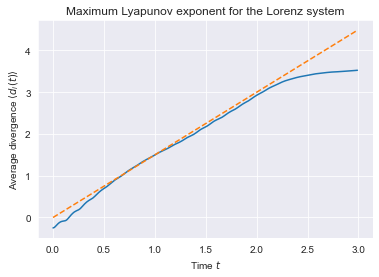

In [232]:
sample = 0.01
x0 = [0.62225717, -0.08232857, 30.60845379]
x = data.lorenz(length=5000, sample=sample, x0=x0,
                sigma=16.0, beta=4.0, rho=45.92)[1][:, 0]

nolds.lyap_r(x, emb_dim=5, lag=13)

# Choose appropriate Theiler window.
window = 60

# Time delay.
tau = 13

# Embedding dimension.
dim = [5]

d = lyapunov.mle_embed(x, dim=dim, tau=tau, maxt=300, window=window)[0]
t = np.arange(300)

plt.title('Maximum Lyapunov exponent for the Lorenz system')
plt.xlabel(r'Time $t$')
plt.ylabel(r'Average divergence $\langle d_i(t) \rangle$')
plt.plot(sample * t, d)
plt.plot(sample * t, sample * t * 1.50, '--')

plt.show()

### Reconstruccion del atractor con $d=3$ y $\tau = 6$ para RM

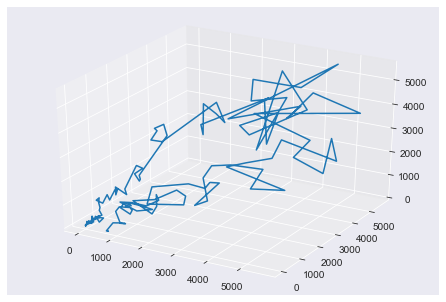

In [233]:
tau_op = 6

figg = plt.figure(15)
plt.clf()
axes = Axes3D(figg)
data_lag0 = np.array(RM)[:-2].flatten()
data_lag1 = np.roll(np.array(RM), -tau_op)[:-2].flatten()
data_lag2 = np.roll(np.array(RM), -2 * tau_op)[:-2].flatten()
axes.plot3D(data_lag0, data_lag1, data_lag2)
figg.add_axes(axes)
plt.show()

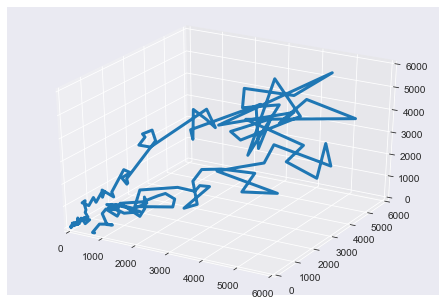

In [234]:
fig = plt.figure(16)
plt.clf()
axes = Axes3D(fig, xlim=(0, 6000), ylim=(0, 6000), zlim=(0, 6000))

line, = axes.plot([], [], [], lw=3)

def init():
    line.set_data([], [], [])
    return line, 

def animate(i):
    X = np.array(RM)[:-2].flatten()[:i]
    Y = np.roll(np.array(RM), -tau_op)[:-2].flatten()[:i]
    Z = np.roll(np.array(RM), -2 * tau_op)[:-2].flatten()[:i]
    line.set_data(X, Y)
    line.set_3d_properties(Z)
    return line,

anim = animation.FuncAnimation(fig, animate, # init_func=init,
                               frames=165, interval=40, blit=True)

from IPython.display import HTML
HTML(anim.to_jshtml())

### Reconstruccion del atractor con $d=3$ y $\tau = 1$ para RM

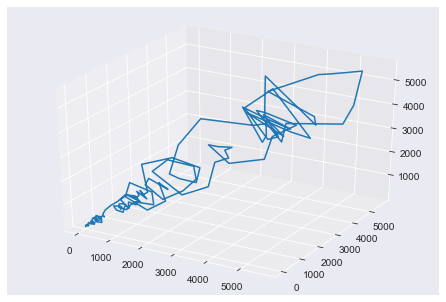

In [235]:
tau_op = 1

figg = plt.figure(15)
plt.clf()
axes = Axes3D(figg)
data_lag0 = np.array(RM)[:-2].flatten()
data_lag1 = np.roll(np.array(RM), -tau_op)[:-2].flatten()
data_lag2 = np.roll(np.array(RM), -2 * tau_op)[:-2].flatten()
axes.plot3D(data_lag0, data_lag1, data_lag2)
figg.add_axes(axes)
plt.show()

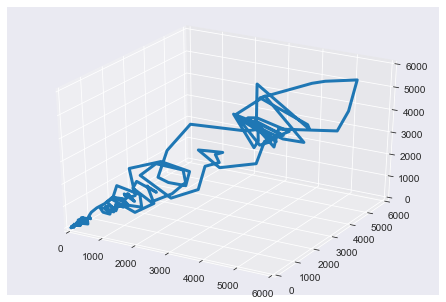

In [236]:
fig = plt.figure(16)
plt.clf()
axes = Axes3D(fig, xlim=(0, 6000), ylim=(0, 6000), zlim=(0, 6000))

line, = axes.plot([], [], [], lw=3)

def init():
    line.set_data([], [], [])
    return line, 

def animate(i):
    X = np.array(RM)[:-2].flatten()[:i]
    Y = np.roll(np.array(RM), -tau_op)[:-2].flatten()[:i]
    Z = np.roll(np.array(RM), -2 * tau_op)[:-2].flatten()[:i]
    line.set_data(X, Y)
    line.set_3d_properties(Z)
    return line,

anim = animation.FuncAnimation(fig, animate, # init_func=init,
                               frames=165, interval=40, blit=True)

from IPython.display import HTML
HTML(anim.to_jshtml())

### Reconstruccion del atractor con $d=3$ y $\tau = 1$ para $C(RM)$

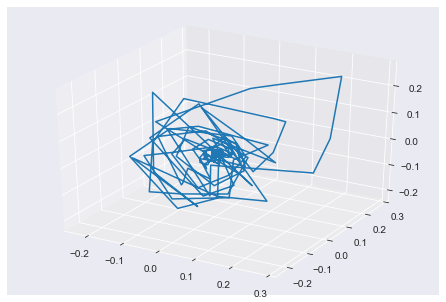

In [237]:
tau_op = 1

figg = plt.figure(15)
plt.clf()
axes = Axes3D(figg)
data_lag0 = np.array(RM_cycle)[:-2].flatten()
data_lag1 = np.roll(np.array(RM_cycle), -tau_op)[:-2].flatten()
data_lag2 = np.roll(np.array(RM_cycle), -2 * tau_op)[:-2].flatten()
axes.plot3D(data_lag0, data_lag1, data_lag2)
figg.add_axes(axes)
plt.show()

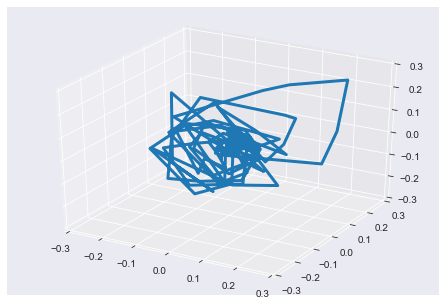

In [238]:
fig = plt.figure(16)
plt.clf()
axes = Axes3D(fig, xlim=(-0.3, 0.3), ylim=(-0.3, 0.3), zlim=(-0.3, 0.3))

line, = axes.plot([], [], [], lw=3)

def init():
    line.set_data([], [], [])
    return line, 

def animate(i):
    X = np.array(RM_cycle)[:-2].flatten()[:i]
    Y = np.roll(np.array(RM_cycle), -tau_op)[:-2].flatten()[:i]
    Z = np.roll(np.array(RM_cycle), -2 * tau_op)[:-2].flatten()[:i]
    line.set_data(X, Y)
    line.set_3d_properties(Z)
    return line,

anim = animation.FuncAnimation(fig, animate, # init_func=init,
                               frames=165, interval=40, blit=True)

from IPython.display import HTML
HTML(anim.to_jshtml())

### Reconstruccion del atractor con $d=3$ y $\tau = 4$ para $C(RM)$

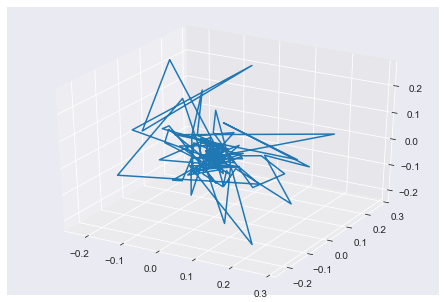

In [239]:
tau_op = 4

figg = plt.figure(15)
plt.clf()
axes = Axes3D(figg)
data_lag0 = np.array(RM_cycle)[:-2].flatten()
data_lag1 = np.roll(np.array(RM_cycle), -tau_op)[:-2].flatten()
data_lag2 = np.roll(np.array(RM_cycle), -2 * tau_op)[:-2].flatten()
axes.plot3D(data_lag0, data_lag1, data_lag2)
figg.add_axes(axes)
plt.show()

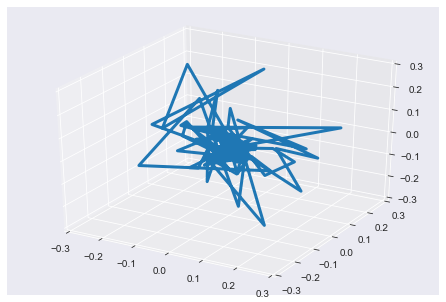

In [240]:
fig = plt.figure(16)
plt.clf()
axes = Axes3D(fig, xlim=(-0.3, 0.3), ylim=(-0.3, 0.3), zlim=(-0.3, 0.3))

line, = axes.plot([], [], [], lw=3)

def init():
    line.set_data([], [], [])
    return line, 

def animate(i):
    X = np.array(RM_cycle)[:-2].flatten()[:i]
    Y = np.roll(np.array(RM_cycle), -tau_op)[:-2].flatten()[:i]
    Z = np.roll(np.array(RM_cycle), -2 * tau_op)[:-2].flatten()[:i]
    line.set_data(X, Y)
    line.set_3d_properties(Z)
    return line,

anim = animation.FuncAnimation(fig, animate, # init_func=init,
                               frames=165, interval=40, blit=True)

from IPython.display import HTML
HTML(anim.to_jshtml())